In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# 한국어 처리
sns.set(font = 'Malgun Gothic')
from IPython.display  import set_matplotlib_formats
set_matplotlib_formats('retina')

In [5]:
#실적데이터
dfm = pd.read_csv("data/실적데이터정제1_time.csv", encoding = "cp949", index_col = [0])

#시청률데이터(veiwtime_w)
vt = pd.read_csv("data/viewtime_w.csv", index_col = [0])

In [7]:
vt.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8760 entries, 0 to 8759
Data columns (total 11 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   date     8760 non-null   object 
 1   month    8760 non-null   int64  
 2   hour     8760 non-null   int64  
 3   rate     8760 non-null   float64
 4   weekday  8760 non-null   object 
 5   min_c    8760 non-null   float64
 6   max_c    8760 non-null   float64
 7   rain     8760 non-null   int64  
 8   snow     8760 non-null   int64  
 9   PM       8760 non-null   float64
 10  state    8760 non-null   object 
dtypes: float64(4), int64(4), object(3)
memory usage: 821.2+ KB


In [10]:
vt

,date,month,hour,rate,weekday,min_c,max_c,rain,snow,PM,state
0,2019-01-01,1,0,0.012,화,-8.2,-0.6,0,0,39.36,보통
1,2019-01-01,1,1,0.034,화,-8.2,-0.6,0,0,39.36,보통
2,2019-01-01,1,2,0.014,화,-8.2,-0.6,0,0,39.36,보통
3,2019-01-01,1,3,0.014,화,-8.2,-0.6,0,0,39.36,보통
4,2019-01-01,1,4,0.014,화,-8.2,-0.6,0,0,39.36,보통
...,...,...,...,...,...,...,...,...,...,...,...
8755,2019-12-31,12,19,0.033,화,-10.9,-4.5,0,0,24.44,좋음
8756,2019-12-31,12,20,0.018,화,-10.9,-4.5,0,0,24.44,좋음
8757,2019-12-31,12,21,0.028,화,-10.9,-4.5,0,0,24.44,좋음
8758,2019-12-31,12,22,0.108,화,-10.9,-4.5,0,0,24.44,좋음


In [8]:
dfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15258 entries, 0 to 15257
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   방송일시    15258 non-null  object 
 1   hour    15258 non-null  int64  
 2   ampm    15258 non-null  object 
 3   마더코드    15258 non-null  int64  
 4   상품코드    15258 non-null  int64  
 5   상품명     15258 non-null  object 
 6   상품군     15258 non-null  object 
 7   판매단가    15258 non-null  int64  
 8   노출시간    15258 non-null  float64
 9   취급액     15258 non-null  float64
 10  판매개수    15258 non-null  float64
dtypes: float64(3), int64(4), object(4)
memory usage: 1.4+ MB


In [9]:
dfm

,방송일시,hour,ampm,마더코드,상품코드,상품명,상품군,판매단가,노출시간,취급액,판매개수
0,2019-01-01,13,PM,100305,200970,오모떼 360도 텐션업 레이스 패키지 시즌4,속옷,109000,60.0,111546000.0,1024.0
1,2019-01-01,14,PM,100377,201220,그렉노먼 남성 구스다운 롱 벤치코트,의류,119000,60.0,51795000.0,436.0
2,2019-01-01,14,PM,100377,201226,그렉노먼 여성 구스다운 롱 벤치코트,의류,119000,60.0,68135000.0,573.0
3,2019-01-01,15,PM,100496,201497,뽕셰프 이봉원 특갈비탕 12팩,농수축,60900,60.0,86177000.0,1416.0
4,2019-01-01,16,PM,100322,201479,국내산 손질갑오징어 8팩,농수축,49900,40.0,176244000.0,3532.0
...,...,...,...,...,...,...,...,...,...,...,...
15253,2019-12-31,12,PM,100837,202480,일시불 쿠쿠전기밥솥 10인용 (QS),주방,208000,40.0,20432000.0,99.0
15254,2020-01-01,0,AM,100448,201383,무이자쿠첸압력밥솥 10인용,주방,178000,20.0,50929000.0,287.0
15255,2020-01-01,0,AM,100448,201384,무이자쿠첸압력밥솥 6인용,주방,158000,20.0,13765000.0,88.0
15256,2020-01-01,0,AM,100448,201390,일시불쿠첸압력밥솥 10인용,주방,168000,20.0,104392000.0,622.0


In [15]:
data1 = pd.merge(dfm, vt, how="left", left_on = ("방송일시","hour"), right_on = ('date','hour'))
data1
# data = pd.merge(df1,t1,how= 'left',left_on = ('방송일시','time'), right_on = ('방송일시','time'))

,방송일시,hour,ampm,마더코드,상품코드,상품명,상품군,판매단가,노출시간,취급액,...,date,month,rate,weekday,min_c,max_c,rain,snow,PM,state
0,2019-01-01,13,PM,100305,200970,오모떼 360도 텐션업 레이스 패키지 시즌4,속옷,109000,60.0,111546000.0,...,2019-01-01,1.0,0.010,화,-8.2,-0.6,0.0,0.0,39.36,보통
1,2019-01-01,14,PM,100377,201220,그렉노먼 남성 구스다운 롱 벤치코트,의류,119000,60.0,51795000.0,...,2019-01-01,1.0,0.049,화,-8.2,-0.6,0.0,0.0,39.36,보통
2,2019-01-01,14,PM,100377,201226,그렉노먼 여성 구스다운 롱 벤치코트,의류,119000,60.0,68135000.0,...,2019-01-01,1.0,0.049,화,-8.2,-0.6,0.0,0.0,39.36,보통
3,2019-01-01,15,PM,100496,201497,뽕셰프 이봉원 특갈비탕 12팩,농수축,60900,60.0,86177000.0,...,2019-01-01,1.0,0.069,화,-8.2,-0.6,0.0,0.0,39.36,보통
4,2019-01-01,16,PM,100322,201479,국내산 손질갑오징어 8팩,농수축,49900,40.0,176244000.0,...,2019-01-01,1.0,0.037,화,-8.2,-0.6,0.0,0.0,39.36,보통
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15253,2019-12-31,12,PM,100837,202480,일시불 쿠쿠전기밥솥 10인용 (QS),주방,208000,40.0,20432000.0,...,2019-12-31,12.0,0.065,화,-10.9,-4.5,0.0,0.0,24.44,좋음
15254,2020-01-01,0,AM,100448,201383,무이자쿠첸압력밥솥 10인용,주방,178000,20.0,50929000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15255,2020-01-01,0,AM,100448,201384,무이자쿠첸압력밥솥 6인용,주방,158000,20.0,13765000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15256,2020-01-01,0,AM,100448,201390,일시불쿠첸압력밥솥 10인용,주방,168000,20.0,104392000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
data1 = data1.dropna()

In [21]:
data1

,방송일시,hour,ampm,마더코드,상품코드,상품명,상품군,판매단가,노출시간,취급액,...,date,month,rate,weekday,min_c,max_c,rain,snow,PM,state
0,2019-01-01,13,PM,100305,200970,오모떼 360도 텐션업 레이스 패키지 시즌4,속옷,109000,60.0,111546000.0,...,2019-01-01,1.0,0.010,화,-8.2,-0.6,0.0,0.0,39.36,보통
1,2019-01-01,14,PM,100377,201220,그렉노먼 남성 구스다운 롱 벤치코트,의류,119000,60.0,51795000.0,...,2019-01-01,1.0,0.049,화,-8.2,-0.6,0.0,0.0,39.36,보통
2,2019-01-01,14,PM,100377,201226,그렉노먼 여성 구스다운 롱 벤치코트,의류,119000,60.0,68135000.0,...,2019-01-01,1.0,0.049,화,-8.2,-0.6,0.0,0.0,39.36,보통
3,2019-01-01,15,PM,100496,201497,뽕셰프 이봉원 특갈비탕 12팩,농수축,60900,60.0,86177000.0,...,2019-01-01,1.0,0.069,화,-8.2,-0.6,0.0,0.0,39.36,보통
4,2019-01-01,16,PM,100322,201479,국내산 손질갑오징어 8팩,농수축,49900,40.0,176244000.0,...,2019-01-01,1.0,0.037,화,-8.2,-0.6,0.0,0.0,39.36,보통
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15249,2019-12-31,12,PM,100253,200864,안동간고등어 20팩,농수축,30900,20.0,63460000.0,...,2019-12-31,12.0,0.065,화,-10.9,-4.5,0.0,0.0,24.44,좋음
15250,2019-12-31,12,PM,100837,202467,무이자 쿠쿠전기밥솥 10인용(CRP-QS107FG/FS),주방,218000,40.0,45139000.0,...,2019-12-31,12.0,0.065,화,-10.9,-4.5,0.0,0.0,24.44,좋음
15251,2019-12-31,12,PM,100837,202470,무이자 쿠쿠전기밥솥 6인용(QS),주방,208000,40.0,6355000.0,...,2019-12-31,12.0,0.065,화,-10.9,-4.5,0.0,0.0,24.44,좋음
15252,2019-12-31,12,PM,100837,202473,일시불 쿠쿠전기밥솥 6인용(QS),주방,198000,40.0,10523000.0,...,2019-12-31,12.0,0.065,화,-10.9,-4.5,0.0,0.0,24.44,좋음


In [29]:
dfm = dfm.sort_values(by = ['방송일시','hour'])

In [30]:
dfm.to_csv('data/total1.csv')

In [31]:
df_속옷 = dfm[dfm["상품군"]=="속옷"]
df_의류 = dfm[dfm["상품군"]=="의류"]
df_농수축 = dfm[dfm["상품군"]=="농수축"]
df_미용 = dfm[dfm["상품군"]=="이미용"]
df_가전 = dfm[dfm["상품군"]=="가전"]
df_주방 = dfm[dfm["상품군"]=="주방"]
df_생활 = dfm[dfm["상품군"]=="생활용품"]
df_건강 = dfm[dfm["상품군"]=="건강기능"]
df_잡화 = dfm[dfm["상품군"]=="잡화"]
df_가구 = dfm[dfm["상품군"]=="가구"]
df_침구 = dfm[dfm["상품군"]=="침구"]

C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:183: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


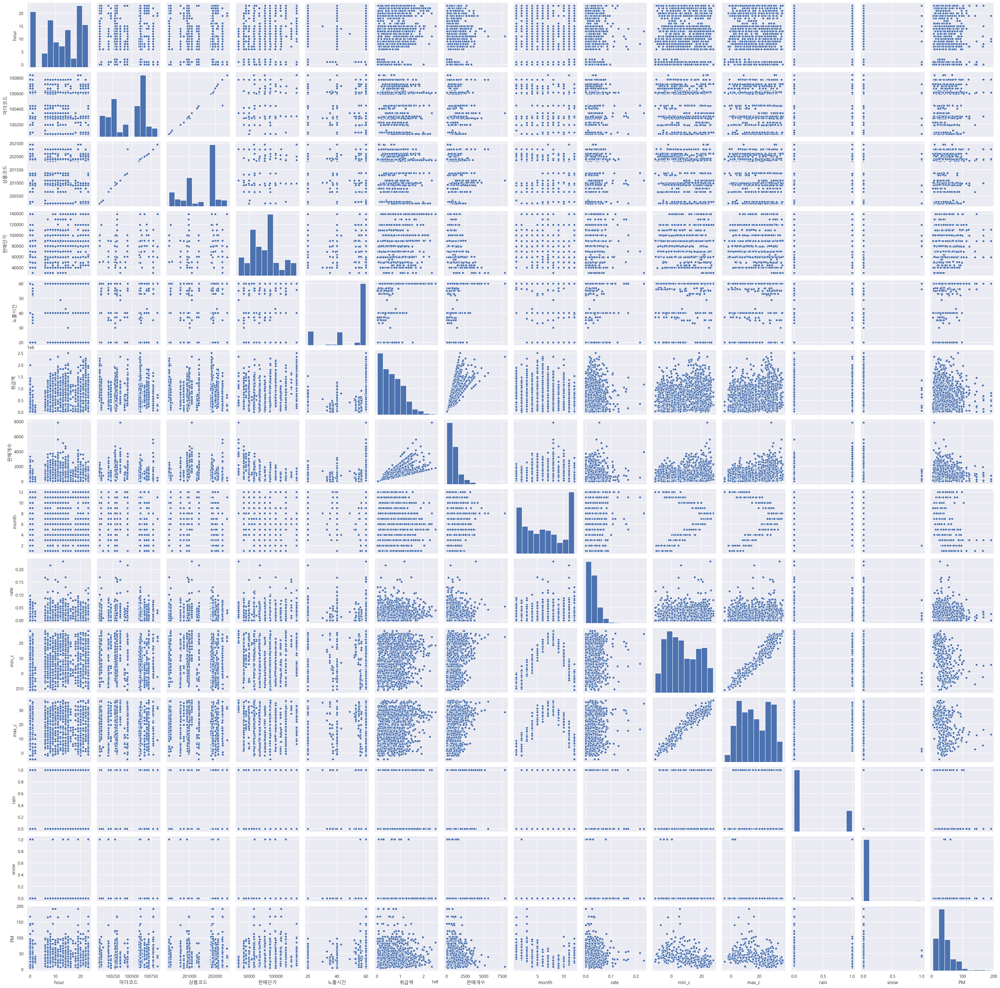

In [33]:
sns.pairplot(df_속옷)

In [36]:
dfm.columns

Index(['방송일시', 'hour', 'ampm', '마더코드', '상품코드', '상품명', '상품군', '판매단가', '노출시간',
       '취급액', '판매개수', 'date', 'month', 'rate', 'weekday', 'min_c', 'max_c',
       'rain', 'snow', 'PM', 'state'],
      dtype='object')

In [42]:
data2 = dfm[['date', 'month','hour','상품군','상품명','판매단가','노출시간','판매개수','취급액' ,'rate', 'weekday', 'PM', 'state']].reset_index(drop=True)
data2

,date,month,hour,상품군,상품명,판매단가,노출시간,판매개수,취급액,rate,weekday,PM,state
0,2019-01-01,1.0,6,의류,테이트 남성 셀린니트3종,39900,60.0,302.0,12033000.0,0.000,화,39.36,보통
1,2019-01-01,1.0,6,의류,테이트 여성 셀린니트3종,39900,60.0,518.0,20663000.0,0.000,화,39.36,보통
2,2019-01-01,1.0,7,속옷,오모떼 레이스 파운데이션 브라,59000,60.0,812.0,47878000.0,0.000,화,39.36,보통
3,2019-01-01,1.0,8,의류,CERINI by PAT 남성 소프트 기모 릴렉스팬츠,59900,60.0,1666.0,99736000.0,0.035,화,39.36,보통
4,2019-01-01,1.0,9,의류,보코 리버시블 무스탕,79000,60.0,1152.0,90973000.0,0.011,화,39.36,보통
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15249,2019-12-31,12.0,22,가전,일시불 LG전자 매직스페이스 냉장고,1359000,20.0,54.0,72733000.0,0.108,화,24.44,좋음
15250,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 10인용,178000,40.0,78.0,13722000.0,0.038,화,24.44,좋음
15251,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 6인용,158000,40.0,19.0,2948000.0,0.038,화,24.44,좋음
15252,2019-12-31,12.0,23,주방,일시불쿠첸압력밥솥 10인용,168000,40.0,146.0,24411000.0,0.038,화,24.44,좋음


In [49]:
rate = pd.read_csv('data/시청률count.csv', index_col = [0])
rate

,date,hour,rate
0,2019-01-01,0,10
1,2019-01-01,1,2
2,2019-01-01,2,1
3,2019-01-01,3,20
4,2019-01-01,4,60
...,...,...,...
8755,2019-12-31,19,11
8756,2019-12-31,20,4
8757,2019-12-31,21,4
8758,2019-12-31,22,37


In [54]:
data3 = pd.merge(data2, rate, how="left", left_on = ("date", 'hour'), right_on = ('date','hour'))

In [58]:
data3 = data3.rename(columns = {'rate_x' : '시청률', "rate_y":"rate_count"})
data3

,date,month,hour,상품군,상품명,판매단가,노출시간,판매개수,취급액,시청률,weekday,PM,state,rate_count
0,2019-01-01,1.0,6,의류,테이트 남성 셀린니트3종,39900,60.0,302.0,12033000.0,0.000,화,39.36,보통,0
1,2019-01-01,1.0,6,의류,테이트 여성 셀린니트3종,39900,60.0,518.0,20663000.0,0.000,화,39.36,보통,0
2,2019-01-01,1.0,7,속옷,오모떼 레이스 파운데이션 브라,59000,60.0,812.0,47878000.0,0.000,화,39.36,보통,0
3,2019-01-01,1.0,8,의류,CERINI by PAT 남성 소프트 기모 릴렉스팬츠,59900,60.0,1666.0,99736000.0,0.035,화,39.36,보통,1
4,2019-01-01,1.0,9,의류,보코 리버시블 무스탕,79000,60.0,1152.0,90973000.0,0.011,화,39.36,보통,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15249,2019-12-31,12.0,22,가전,일시불 LG전자 매직스페이스 냉장고,1359000,20.0,54.0,72733000.0,0.108,화,24.44,좋음,37
15250,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 10인용,178000,40.0,78.0,13722000.0,0.038,화,24.44,좋음,18
15251,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 6인용,158000,40.0,19.0,2948000.0,0.038,화,24.44,좋음,18
15252,2019-12-31,12.0,23,주방,일시불쿠첸압력밥솥 10인용,168000,40.0,146.0,24411000.0,0.038,화,24.44,좋음,18


In [62]:
dfm.to_csv("data/total2.csv")

In [59]:
dfm = data3.copy()

In [60]:
df_속옷 = dfm[dfm["상품군"]=="속옷"]
df_의류 = dfm[dfm["상품군"]=="의류"]
df_농수축 = dfm[dfm["상품군"]=="농수축"]
df_미용 = dfm[dfm["상품군"]=="이미용"]
df_가전 = dfm[dfm["상품군"]=="가전"]
df_주방 = dfm[dfm["상품군"]=="주방"]
df_생활 = dfm[dfm["상품군"]=="생활용품"]
df_건강 = dfm[dfm["상품군"]=="건강기능"]
df_잡화 = dfm[dfm["상품군"]=="잡화"]
df_가구 = dfm[dfm["상품군"]=="가구"]
df_침구 = dfm[dfm["상품군"]=="침구"]

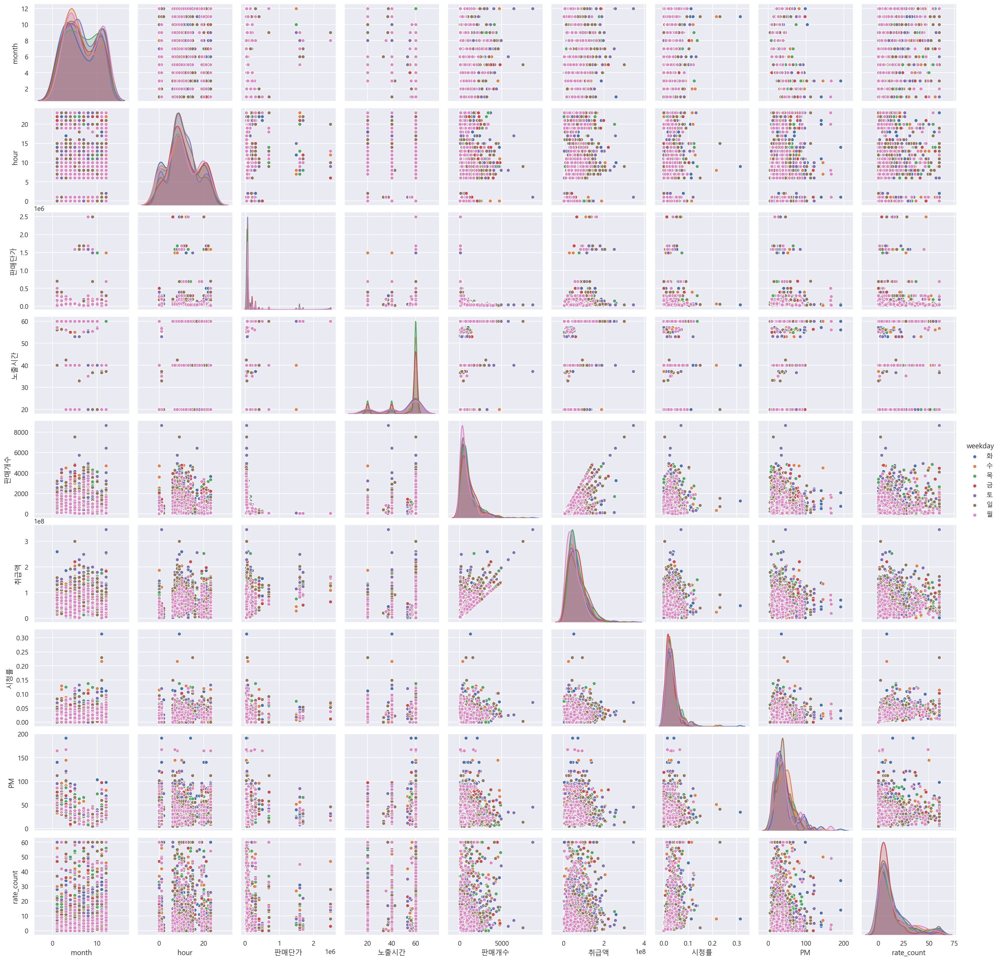

In [63]:
sns.pairplot(df_의류, hue="weekday")

In [4]:
df = pd.read_csv('data/total2.csv', index_col= [0])
df

,date,month,hour,상품군,상품명,판매단가,노출시간,판매개수,취급액,시청률,weekday,PM,state,rate_count
0,2019-01-01,1.0,6,의류,테이트 남성 셀린니트3종,39900,60.0,302.0,12033000.0,0.000,화,39.36,보통,0
1,2019-01-01,1.0,6,의류,테이트 여성 셀린니트3종,39900,60.0,518.0,20663000.0,0.000,화,39.36,보통,0
2,2019-01-01,1.0,7,속옷,오모떼 레이스 파운데이션 브라,59000,60.0,812.0,47878000.0,0.000,화,39.36,보통,0
3,2019-01-01,1.0,8,의류,CERINI by PAT 남성 소프트 기모 릴렉스팬츠,59900,60.0,1666.0,99736000.0,0.035,화,39.36,보통,1
4,2019-01-01,1.0,9,의류,보코 리버시블 무스탕,79000,60.0,1152.0,90973000.0,0.011,화,39.36,보통,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15249,2019-12-31,12.0,22,가전,일시불 LG전자 매직스페이스 냉장고,1359000,20.0,54.0,72733000.0,0.108,화,24.44,좋음,37
15250,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 10인용,178000,40.0,78.0,13722000.0,0.038,화,24.44,좋음,18
15251,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 6인용,158000,40.0,19.0,2948000.0,0.038,화,24.44,좋음,18
15252,2019-12-31,12.0,23,주방,일시불쿠첸압력밥솥 10인용,168000,40.0,146.0,24411000.0,0.038,화,24.44,좋음,18


In [5]:
df_의류 = df[df['상품군']=="의류"]
df_의류

,date,month,hour,상품군,상품명,판매단가,노출시간,판매개수,취급액,시청률,weekday,PM,state,rate_count
0,2019-01-01,1.0,6,의류,테이트 남성 셀린니트3종,39900,60.0,302.0,12033000.0,0.000,화,39.36,보통,0
1,2019-01-01,1.0,6,의류,테이트 여성 셀린니트3종,39900,60.0,518.0,20663000.0,0.000,화,39.36,보통,0
3,2019-01-01,1.0,8,의류,CERINI by PAT 남성 소프트 기모 릴렉스팬츠,59900,60.0,1666.0,99736000.0,0.035,화,39.36,보통,1
4,2019-01-01,1.0,9,의류,보코 리버시블 무스탕,79000,60.0,1152.0,90973000.0,0.011,화,39.36,보통,2
5,2019-01-01,1.0,10,의류,CERINI by PAT 남성 풀패키지 기모니트 3종,79900,60.0,3251.0,259678000.0,0.039,화,39.36,보통,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15200,2019-12-31,12.0,7,의류,크리스티나앤코 리버시블 패딩,49000,20.0,848.0,41540000.0,0.053,화,24.44,좋음,8
15207,2019-12-31,12.0,10,의류,[헤스티지] 레나 폭스퍼후드 덕다운롱코트,299000,40.0,319.0,95087000.0,0.065,화,24.44,좋음,14
15210,2019-12-31,12.0,11,의류,[헤스티지] 레나 폭스퍼후드 덕다운롱코트,299000,20.0,282.0,84192000.0,0.031,화,24.44,좋음,1
15230,2019-12-31,12.0,18,의류,마르엘라로사티 에코무스탕1종,79000,40.0,905.0,71417000.0,0.043,화,24.44,좋음,11


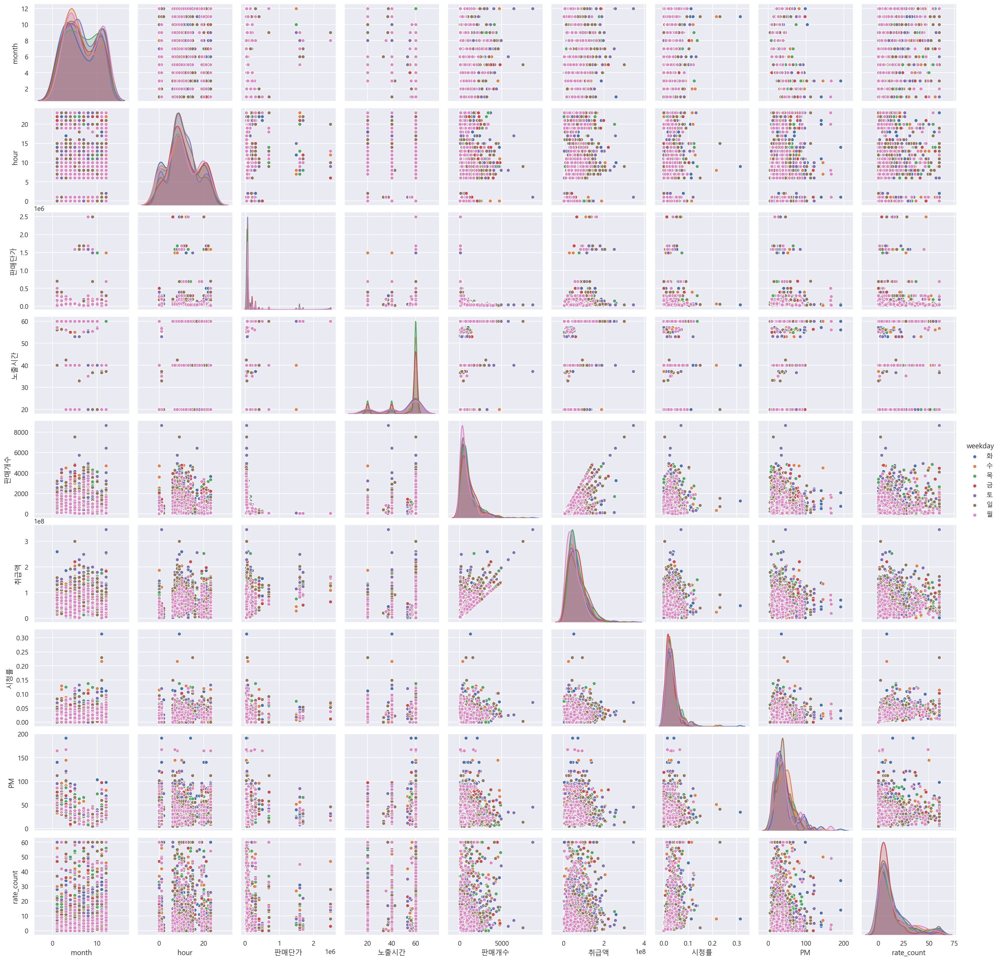

In [14]:
sns.pairplot(df_의류, hue='weekday')

In [13]:
df_의류.sort_values(by="판매단가")

,date,month,hour,상품군,상품명,판매단가,노출시간,판매개수,취급액,시청률,weekday,PM,state,rate_count
9277,2019-08-28,8.0,9,의류,NNF SS트레이닝 세트(8월),29000,60.0,4215.0,122214000.0,0.028,수,29.48,좋음,33
8001,2019-07-26,7.0,13,의류,NNF 쉬폰 썸머 앙상블세트,29000,60.0,3416.0,99043000.0,0.060,금,18.12,좋음,56
3595,2019-04-10,4.0,10,의류,엔셀라두스 밴딩팬츠 3종,29000,60.0,3187.0,92398000.0,0.058,수,6.96,좋음,13
7928,2019-07-24,7.0,12,의류,NNF 쉬폰 썸머 앙상블세트,29000,60.0,4047.0,117358000.0,0.068,수,23.36,좋음,36
7873,2019-07-23,7.0,6,의류,NNF 쉬폰 썸머 앙상블세트,29000,60.0,3010.0,87274000.0,0.014,화,27.12,좋음,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9170,2019-08-25,8.0,10,의류,마르엘라로사티 휘메일 풀스킨 하이넥 밍크코트 1종,2490000,60.0,64.0,157619000.0,0.068,일,19.48,좋음,28
8538,2019-08-09,8.0,6,의류,마르엘라로사티 휘메일 풀스킨 하이넥 밍크코트 1종,2490000,60.0,26.0,64147000.0,0.012,금,27.28,좋음,3
8869,2019-08-17,8.0,9,의류,마르엘라로사티 휘메일 풀스킨 하이넥 밍크코트 1종,2490000,60.0,50.0,124200000.0,0.040,토,32.04,보통,14
9042,2019-08-21,8.0,10,의류,마르엘라로사티 휘메일 풀스킨 하이넥 밍크코트 1종,2490000,60.0,55.0,135736000.0,0.061,수,30.56,보통,47


In [15]:
df_속옷 = df[df["상품군"]=="속옷"]
df_의류 = df[df["상품군"]=="의류"]
df_농수축 = df[df["상품군"]=="농수축"]
df_미용 = df[df["상품군"]=="이미용"]
df_가전 = df[df["상품군"]=="가전"]
df_주방 = df[df["상품군"]=="주방"]
df_생활 = df[df["상품군"]=="생활용품"]
df_건강 = df[df["상품군"]=="건강기능"]
df_잡화 = df[df["상품군"]=="잡화"]
df_가구 = df[df["상품군"]=="가구"]
df_침구 = df[df["상품군"]=="침구"]

C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:183: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


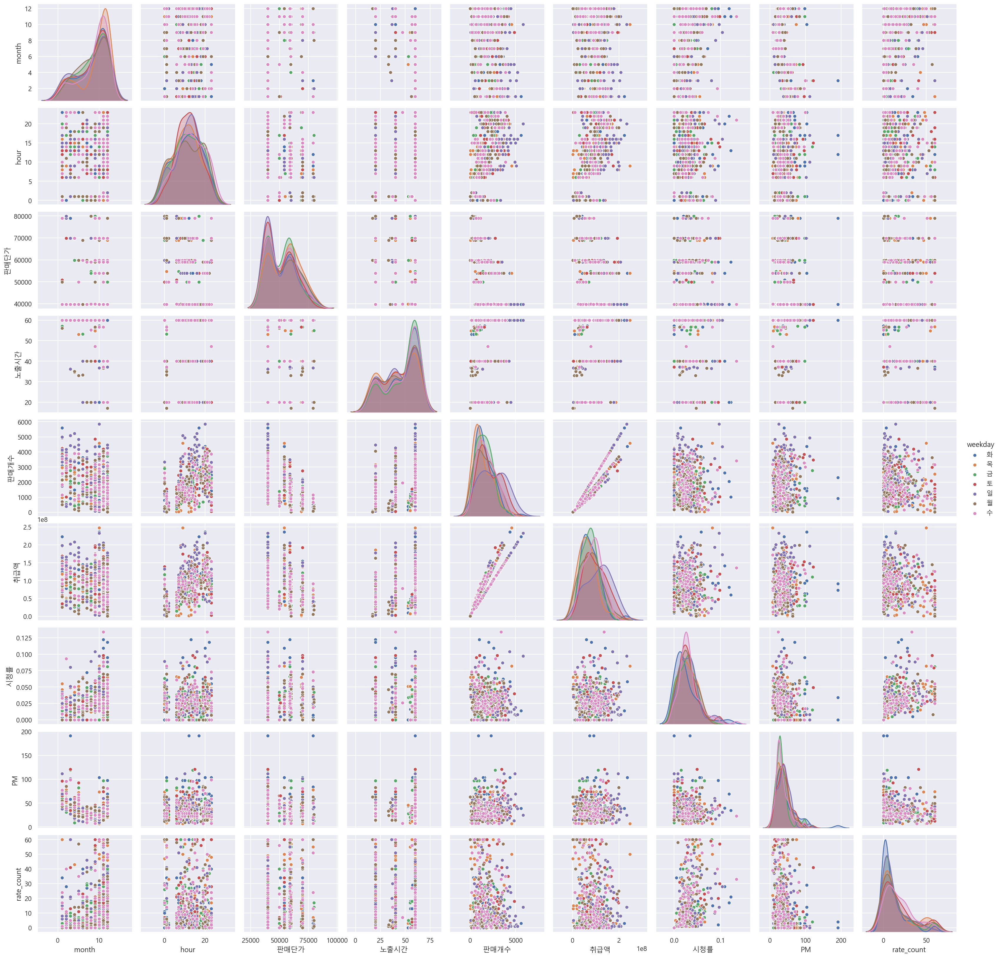

In [16]:
sns.pairplot(df_미용, hue="weekday")

C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:183: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


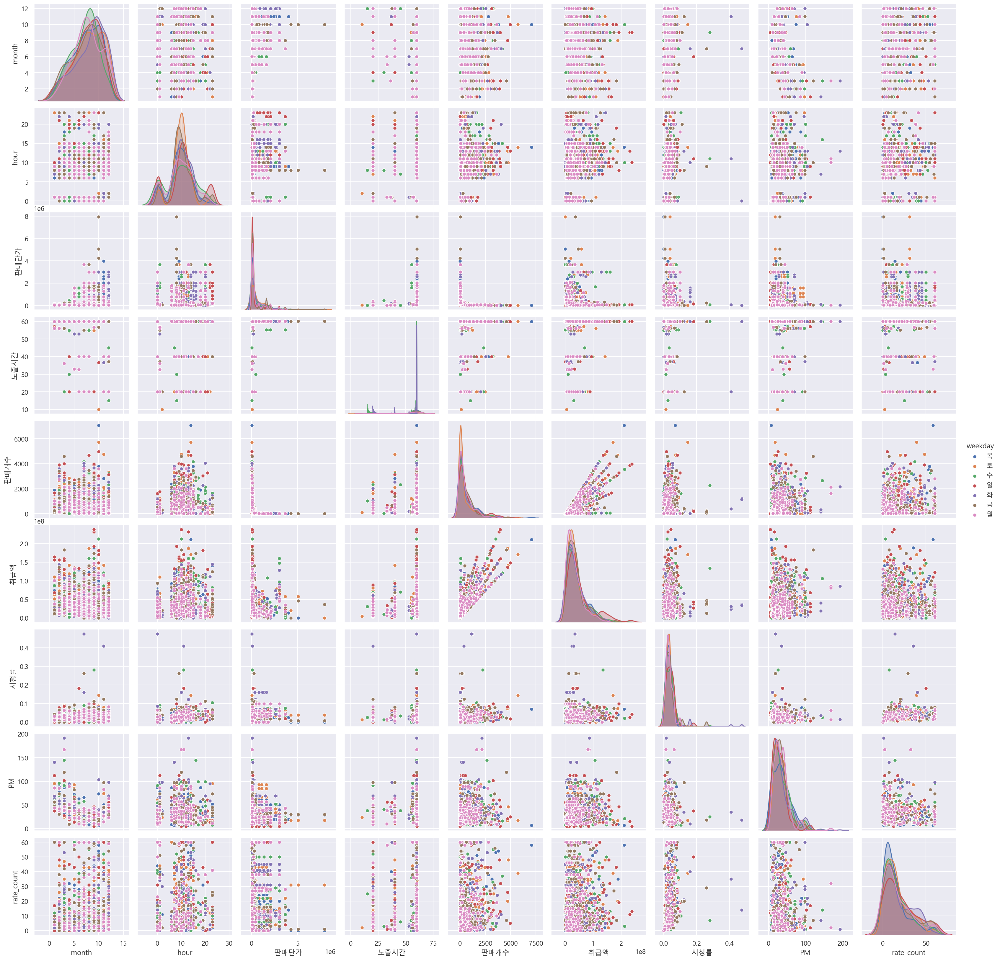

In [17]:
sns.pairplot(df_잡화, hue="weekday")

C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:214: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\hyeah\anaconda3\envs\py37\lib\site-packages\matplotlib\backends\backend_agg.py:183: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


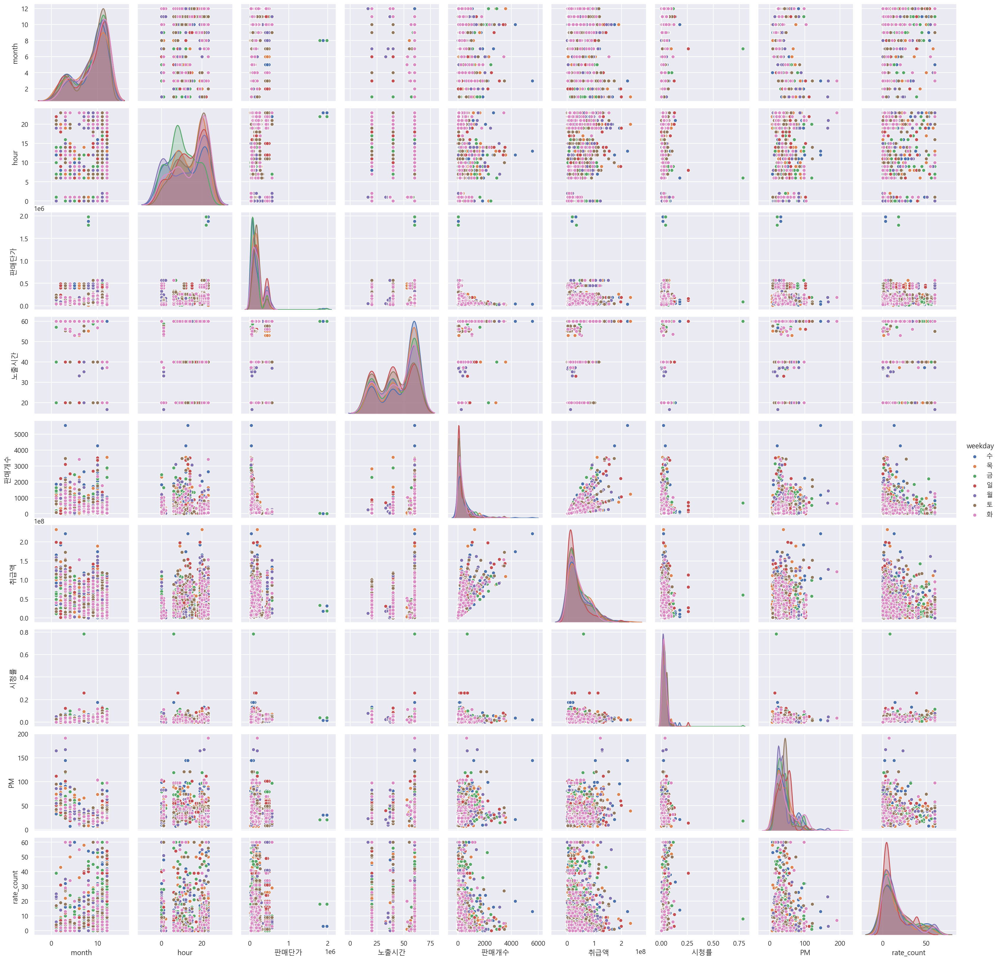

In [18]:
sns.pairplot(df_생활, hue="weekday")

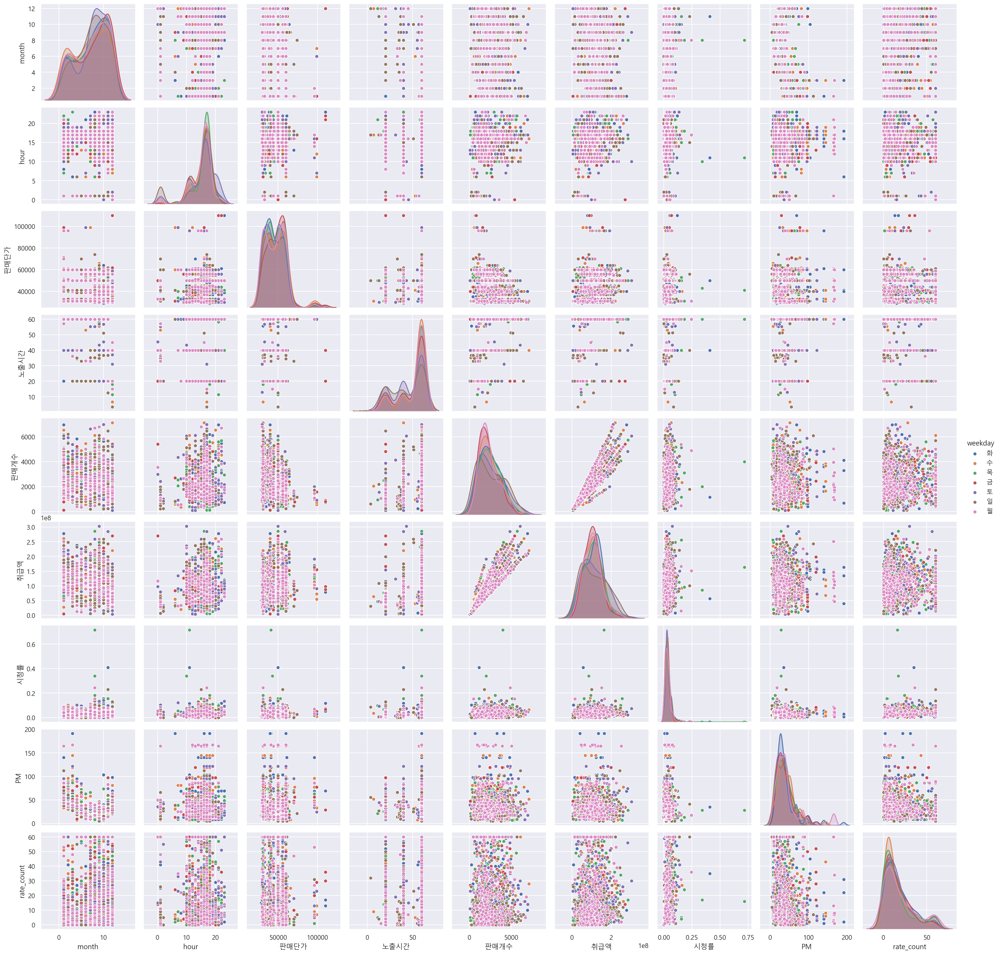

In [19]:
sns.pairplot(df_농수축, hue="weekday")

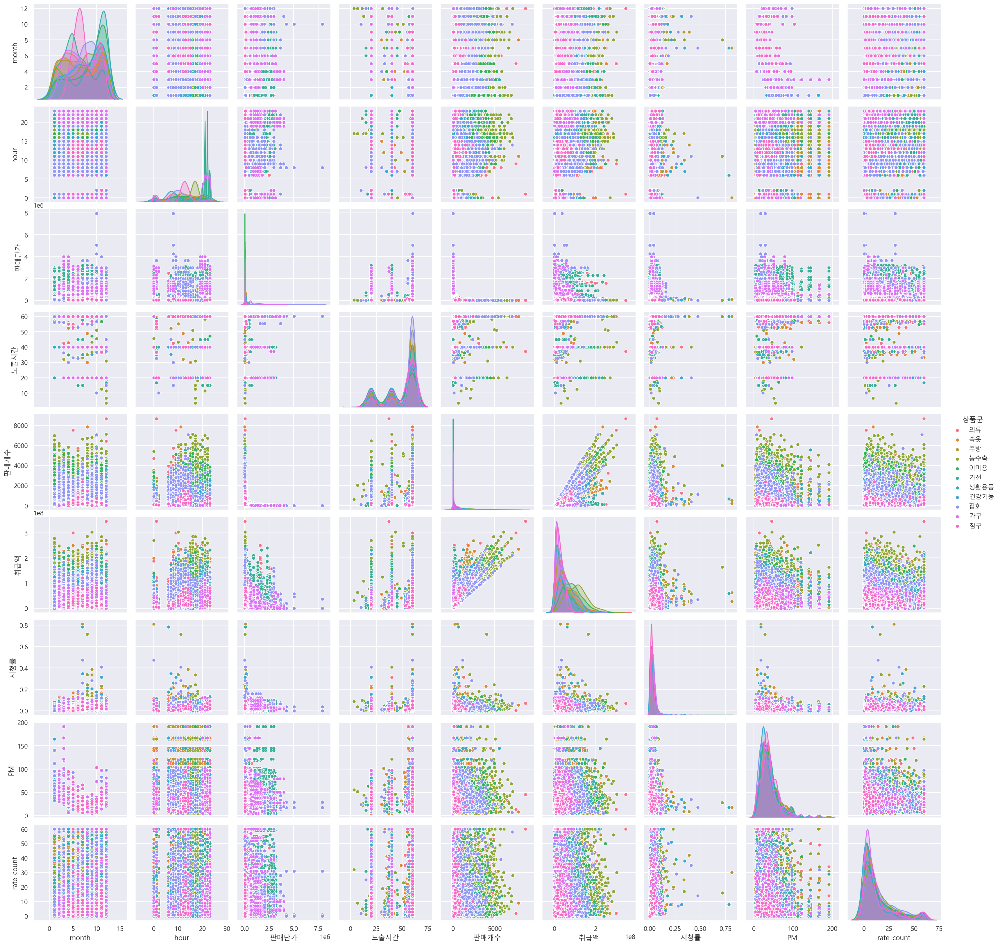

In [20]:
sns.pairplot(df, hue="상품군")

In [31]:
df_시청률 =df[df["시청률"] <=0.1]
df_시청률

,date,month,hour,상품군,상품명,판매단가,노출시간,판매개수,취급액,시청률,weekday,PM,state,rate_count
0,2019-01-01,1.0,6,의류,테이트 남성 셀린니트3종,39900,60.0,302.0,12033000.0,0.000,화,39.36,보통,0
1,2019-01-01,1.0,6,의류,테이트 여성 셀린니트3종,39900,60.0,518.0,20663000.0,0.000,화,39.36,보통,0
2,2019-01-01,1.0,7,속옷,오모떼 레이스 파운데이션 브라,59000,60.0,812.0,47878000.0,0.000,화,39.36,보통,0
3,2019-01-01,1.0,8,의류,CERINI by PAT 남성 소프트 기모 릴렉스팬츠,59900,60.0,1666.0,99736000.0,0.035,화,39.36,보통,1
4,2019-01-01,1.0,9,의류,보코 리버시블 무스탕,79000,60.0,1152.0,90973000.0,0.011,화,39.36,보통,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15247,2019-12-31,12.0,21,생활용품,일시불 국내제조 노비타 뉴스파 비데 무료설치,219000,20.0,281.0,61370000.0,0.028,화,24.44,좋음,4
15250,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 10인용,178000,40.0,78.0,13722000.0,0.038,화,24.44,좋음,18
15251,2019-12-31,12.0,23,주방,무이자쿠첸압력밥솥 6인용,158000,40.0,19.0,2948000.0,0.038,화,24.44,좋음,18
15252,2019-12-31,12.0,23,주방,일시불쿠첸압력밥솥 10인용,168000,40.0,146.0,24411000.0,0.038,화,24.44,좋음,18


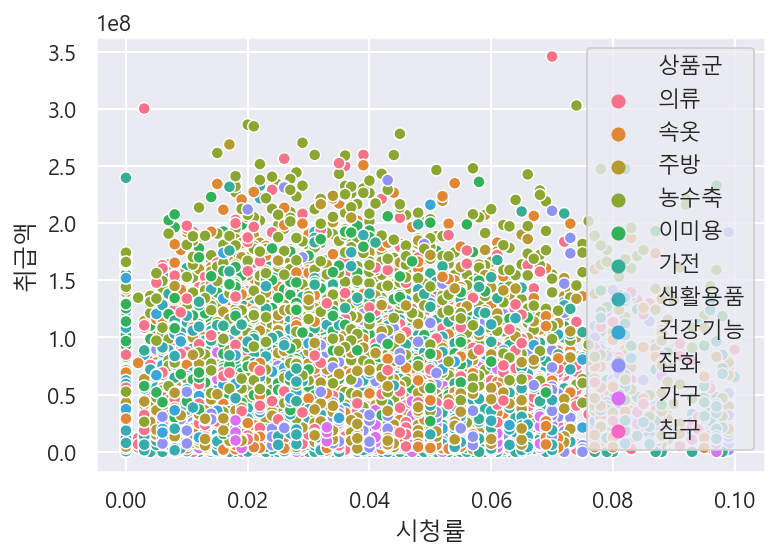

In [32]:
sns.scatterplot(x = df_시청률['시청률'], y=df_시청률['취급액'], hue=df_시청률["상품군"])

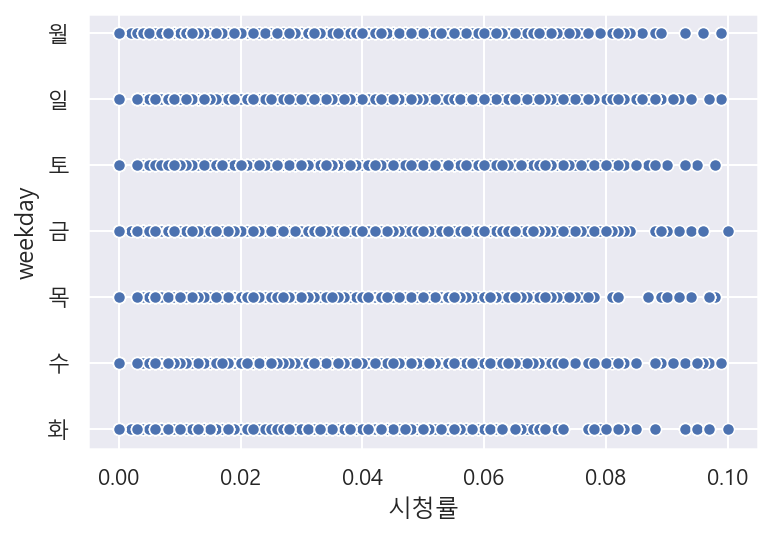

In [33]:
sns.scatterplot(x = df_시청률['시청률'], y=df_시청률["weekday"])

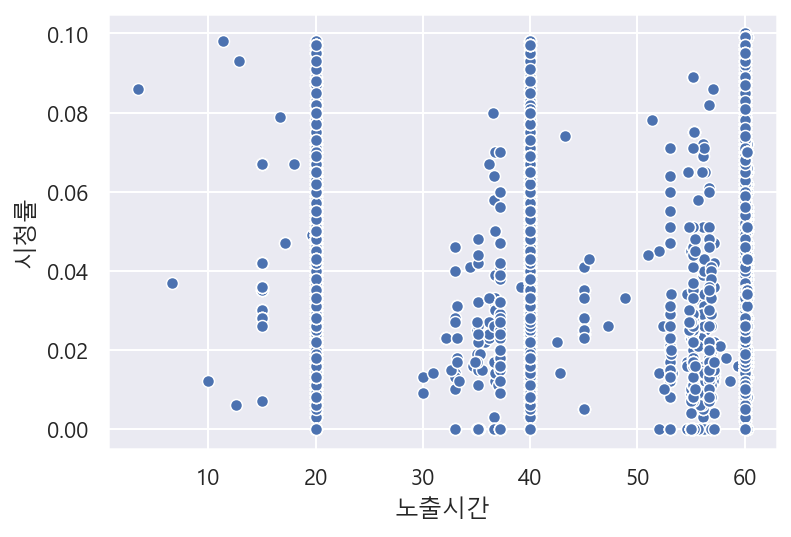

In [34]:
sns.scatterplot(x = df_시청률['노출시간'], y=df_시청률["시청률"])

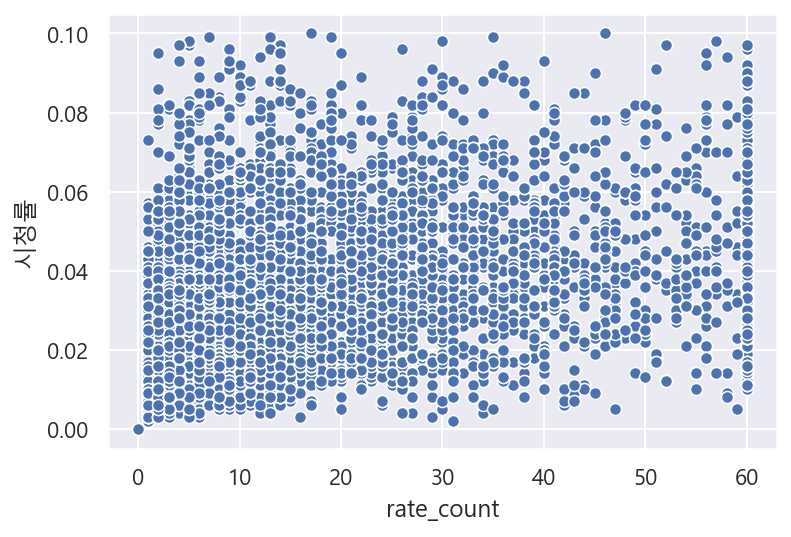

In [35]:
sns.scatterplot(x = df_시청률['rate_count'], y=df_시청률["시청률"])

In [36]:
df_의류

,date,month,hour,상품군,상품명,판매단가,노출시간,판매개수,취급액,시청률,weekday,PM,state,rate_count
0,2019-01-01,1.0,6,의류,테이트 남성 셀린니트3종,39900,60.0,302.0,12033000.0,0.000,화,39.36,보통,0
1,2019-01-01,1.0,6,의류,테이트 여성 셀린니트3종,39900,60.0,518.0,20663000.0,0.000,화,39.36,보통,0
3,2019-01-01,1.0,8,의류,CERINI by PAT 남성 소프트 기모 릴렉스팬츠,59900,60.0,1666.0,99736000.0,0.035,화,39.36,보통,1
4,2019-01-01,1.0,9,의류,보코 리버시블 무스탕,79000,60.0,1152.0,90973000.0,0.011,화,39.36,보통,2
5,2019-01-01,1.0,10,의류,CERINI by PAT 남성 풀패키지 기모니트 3종,79900,60.0,3251.0,259678000.0,0.039,화,39.36,보통,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15200,2019-12-31,12.0,7,의류,크리스티나앤코 리버시블 패딩,49000,20.0,848.0,41540000.0,0.053,화,24.44,좋음,8
15207,2019-12-31,12.0,10,의류,[헤스티지] 레나 폭스퍼후드 덕다운롱코트,299000,40.0,319.0,95087000.0,0.065,화,24.44,좋음,14
15210,2019-12-31,12.0,11,의류,[헤스티지] 레나 폭스퍼후드 덕다운롱코트,299000,20.0,282.0,84192000.0,0.031,화,24.44,좋음,1
15230,2019-12-31,12.0,18,의류,마르엘라로사티 에코무스탕1종,79000,40.0,905.0,71417000.0,0.043,화,24.44,좋음,11


In [37]:
c = df_의류.copy()

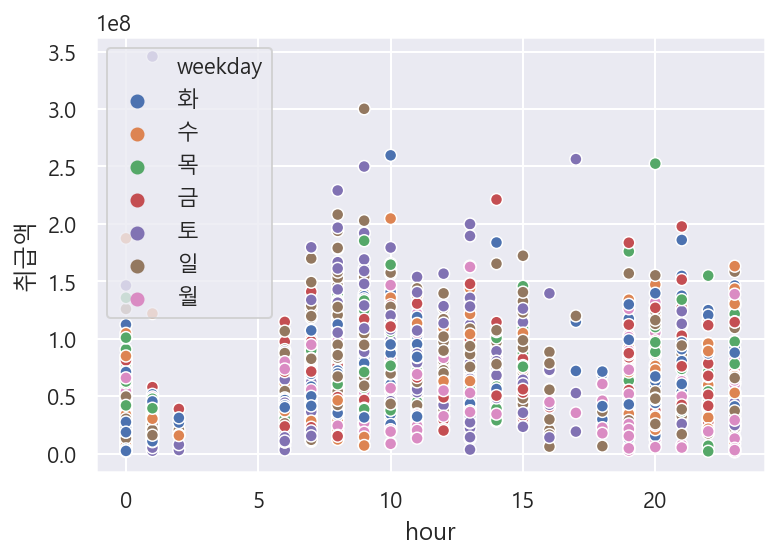

In [42]:
sns.scatterplot(hue=c["weekday"], y=c['취급액'], x=c["hour"])

In [43]:
n = df_농수축.copy()

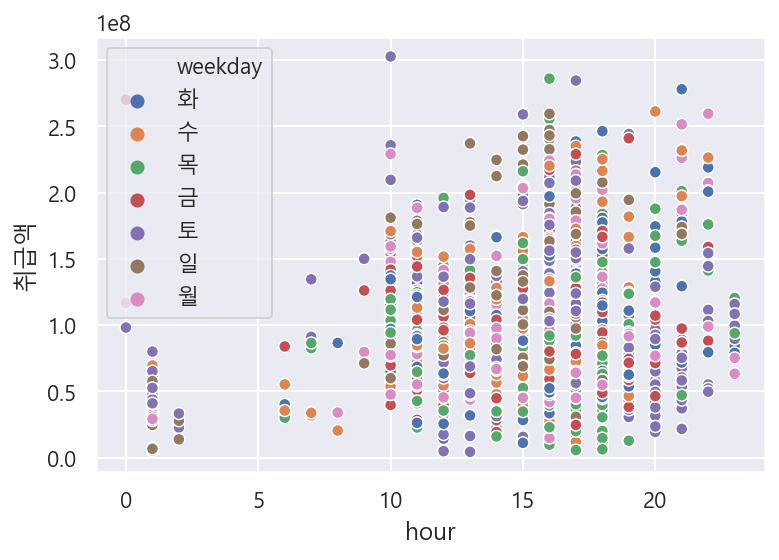

In [44]:
sns.scatterplot(hue=n["weekday"], y=n['취급액'], x=n["hour"])

In [54]:
df_count =  df[['상품군', '판매개수']]
df_count
df_m = df[["상품군",'취급액']]

In [53]:
c1 = df_count.groupby("상품군").sum()
c1.sort_values(by="판매개수")

,판매개수
상품군,
가구,45963.0
가전,101426.0
침구,103086.0
건강기능,294621.0
생활용품,502128.0
잡화,925990.0
이미용,1046493.0
주방,1252975.0
속옷,1425806.0


In [59]:
m1 = df_m.groupby("상품군").sum()
m1.sort_values(by="취급액")

,취급액
상품군,
침구,6.991568e+09
건강기능,2.010362e+10
가구,2.913114e+10
이미용,4.932262e+10
생활용품,5.164199e+10
잡화,6.228568e+10
가전,9.706092e+10
속옷,1.021965e+11
의류,1.058031e+11


In [62]:
df_t = df[["상품군",'노출시간']]
t1 = df_t.groupby("상품군").sum()
t1.sort_values(by="노출시간")

,노출시간
상품군,
침구,13569.816667
건강기능,15937.050000
이미용,25994.733333
가구,52968.016667
생활용품,59037.800000
농수축,76046.733333
속옷,78731.600000
의류,85962.783333
잡화,86649.666667


In [63]:
df_t = df[["상품군",'rate_count']]
t1 = df_t.groupby("상품군").sum()
t1.sort_values(by="rate_count")

,rate_count
상품군,
건강기능,3714
침구,3905
이미용,8453
가구,13435
속옷,19363
생활용품,19669
의류,22239
농수축,25848
잡화,27529
